<a href="https://colab.research.google.com/github/mohripan/Machine-Learning/blob/main/Latihan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install --upgrade --force-reinstall --no-deps -q -U albumentations
!pip install --upgrade --force-reinstall --no-deps -q -U opencv-python
!pip install qudida

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 48.3 MB 46 kB/s 


In [2]:
# -- DO NOT CHANGE THIS CELL -- #
!mkdir /data
!wget -P /data/ https://s3.amazonaws.com/video.udacity-data.com/topher/2018/May/5aea1b91_train-test-data/train-test-data.zip
!unzip -n /data/train-test-data.zip -d /data

mkdir: cannot create directory ‘/data’: File exists
--2022-06-15 14:21:24--  https://s3.amazonaws.com/video.udacity-data.com/topher/2018/May/5aea1b91_train-test-data/train-test-data.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.249.54
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.249.54|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 338613624 (323M) [application/zip]
Saving to: ‘/data/train-test-data.zip.1’

train-test-data.zip 100%[===================>] 322.93M  33.9MB/s    in 10s     

2022-06-15 14:21:35 (31.9 MB/s) - ‘/data/train-test-data.zip.1’ saved [338613624/338613624]

Archive:  /data/train-test-data.zip


In [262]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import cv2
from PIL import Image
import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms

In [6]:
key_pts_frame = pd.read_csv('/data/training_frames_keypoints.csv')
key_pts_frame.head()

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,126,127,128,129,130,131,132,133,134,135
0,Luis_Fonsi_21.jpg,45.0,98.0,47.0,106.0,49.0,110.0,53.0,119.0,56.0,...,83.0,119.0,90.0,117.0,83.0,119.0,81.0,122.0,77.0,122.0
1,Lincoln_Chafee_52.jpg,41.0,83.0,43.0,91.0,45.0,100.0,47.0,108.0,51.0,...,85.0,122.0,94.0,120.0,85.0,122.0,83.0,122.0,79.0,122.0
2,Valerie_Harper_30.jpg,56.0,69.0,56.0,77.0,56.0,86.0,56.0,94.0,58.0,...,79.0,105.0,86.0,108.0,77.0,105.0,75.0,105.0,73.0,105.0
3,Angelo_Reyes_22.jpg,61.0,80.0,58.0,95.0,58.0,108.0,58.0,120.0,58.0,...,98.0,136.0,107.0,139.0,95.0,139.0,91.0,139.0,85.0,136.0
4,Kristen_Breitweiser_11.jpg,58.0,94.0,58.0,104.0,60.0,113.0,62.0,121.0,67.0,...,92.0,117.0,103.0,118.0,92.0,120.0,88.0,122.0,84.0,122.0


In [12]:
n = 1
image_name = key_pts_frame.iloc[n, 0]
key_pts = key_pts_frame.iloc[n, 1:]
key_pts = np.array(key_pts, dtype=np.float32).reshape(-1, 2)

In [153]:
def visualize_keypoints(image, key_pts):
  plt.imshow(image)
  plt.scatter(key_pts[:, 0], key_pts[:, 1], s=20, marker='.', c='m')
  plt.axis('off')
  plt.show()

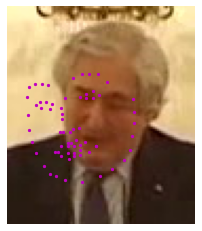

In [159]:
image = cv2.imread(f'/data/training/{image_name}')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

visualize_keypoints(image, key_pts)

In [160]:
image.shape

(103, 89, 3)

In [252]:
transform_training = A.Compose([A.HorizontalFlip(),
                        A.Rotate(limit=45),
                        A.RandomBrightness(),
                        ], keypoint_params=A.KeypointParams(format='xy'))

transform_test = A.Compose([
                            ], keypoint_params = A.KeypointParams(format='xy'))

/usr/local/lib/python3.7/dist-packages/albumentations/augmentations/transforms.py:1615: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,


In [253]:
!ls /data/

test			   training			  train-test-data.zip
test_frames_keypoints.csv  training_frames_keypoints.csv  train-test-data.zip.1


In [254]:
test_frame = pd.read_csv('/data/test_frames_keypoints.csv')
test_frame.head()

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,126,127,128,129,130,131,132,133,134,135
0,James_Wolfensohn_00.jpg,25.0,44.0,25.0,49.0,25.0,54.0,25.0,59.0,26.0,...,42.0,65.0,46.0,65.0,42.0,65.0,39.0,65.0,38.0,65.0
1,Valerie_Harper_30.jpg,55.0,62.0,52.0,72.0,52.0,83.0,55.0,90.0,55.0,...,78.0,104.0,88.0,106.0,78.0,106.0,75.0,104.0,70.0,104.0
2,Kristen_Breitweiser_11.jpg,60.0,88.0,60.0,98.0,63.0,109.0,65.0,116.0,68.0,...,96.0,114.0,106.0,117.0,96.0,117.0,94.0,117.0,89.0,117.0
3,Elizabeth_Dole_31.jpg,41.0,96.0,43.0,104.0,47.0,113.0,49.0,120.0,56.0,...,98.0,118.0,103.0,118.0,98.0,120.0,96.0,122.0,94.0,122.0
4,Kit_Bond_20.jpg,35.0,67.0,37.0,74.0,41.0,81.0,44.0,87.0,48.0,...,76.0,96.0,83.0,93.0,76.0,98.0,73.0,98.0,69.0,98.0


In [267]:
key_pts_frame.max()

Unnamed: 0    Zhong_Nanshan_52.jpg
0                            224.0
1                            210.0
2                            224.0
3                            232.0
                      ...         
131                          278.0
132                          290.0
133                          278.0
134                          285.0
135                          277.0
Length: 137, dtype: object

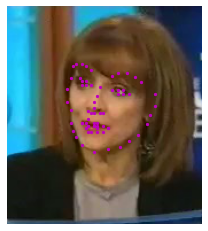

In [255]:
n = 1
image_name = test_frame.iloc[n, 0]
key_pts = test_frame.iloc[n, 1:]
key_pts = np.array(key_pts, dtype=np.float32).reshape(-1, 2)
image = cv2.imread(f'/data/test/{image_name}')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
visualize_keypoints(image, key_pts)

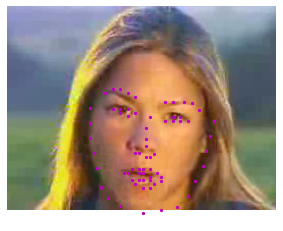

In [301]:
n = 190
image_name = key_pts_frame.iloc[n, 0]
key_pts = key_pts_frame.iloc[n, 1:]
key_pts = np.array(key_pts, dtype=np.float32).reshape(-1, 2)
image = cv2.imread(f'/data/training/{image_name}')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
visualize_keypoints(image, key_pts)

0


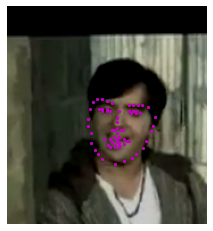

1


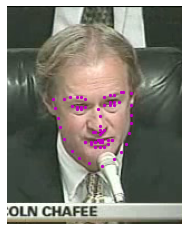

2


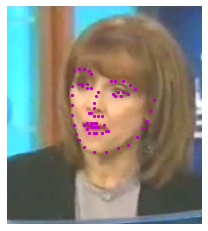

3


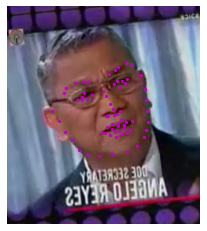

4


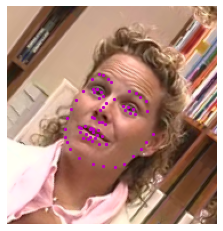

5


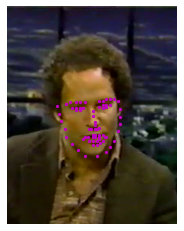

6


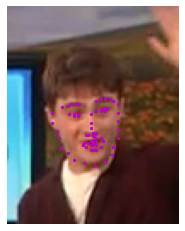

7


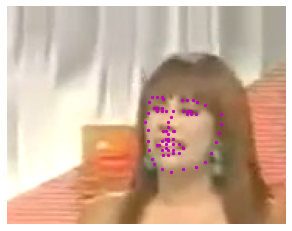

8


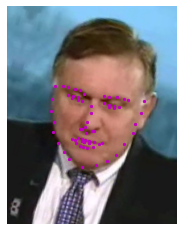

9


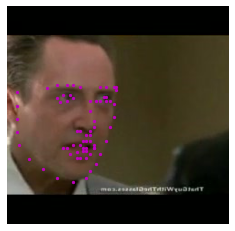

10


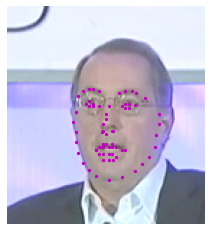

11


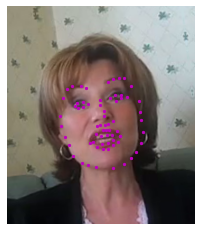

12


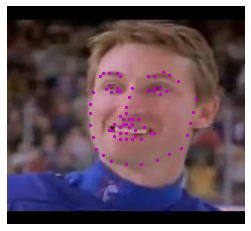

13


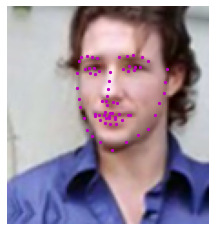

14


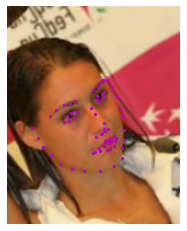

15


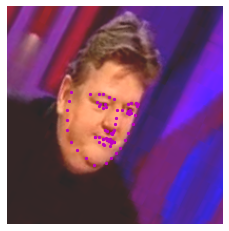

16


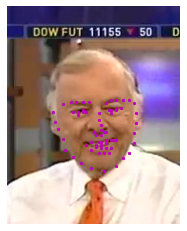

17


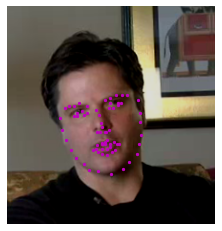

18


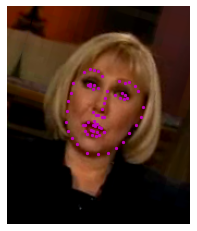

19


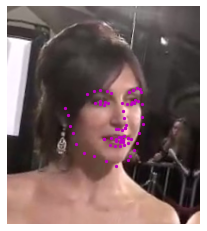

20


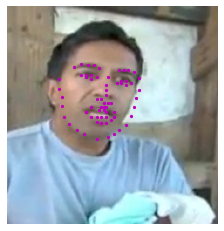

21


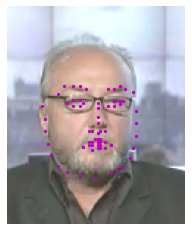

22


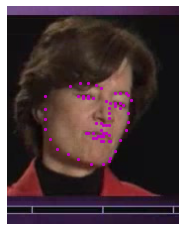

23


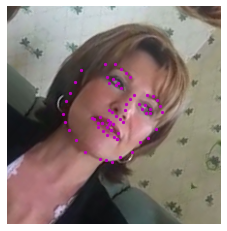

24


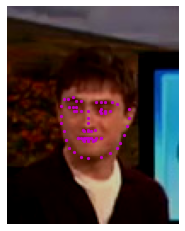

25


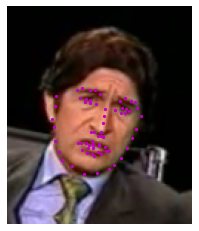

26


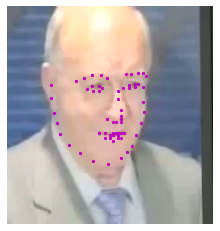

27


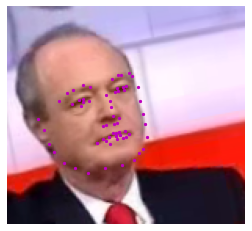

28


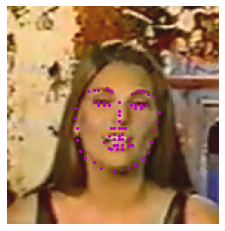

29


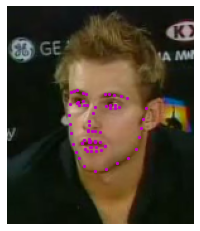

30


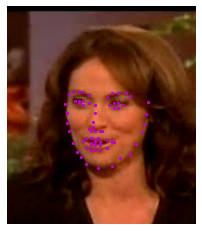

31


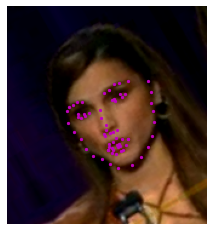

32


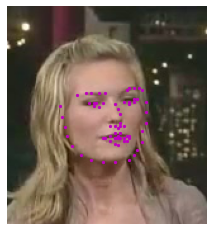

33


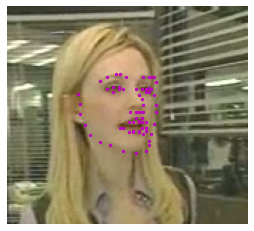

34


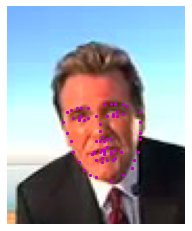

35


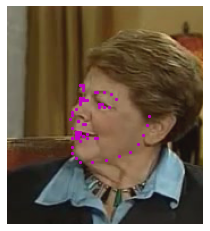

36


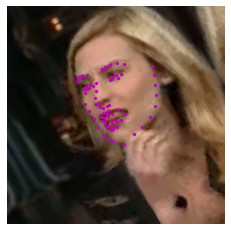

37


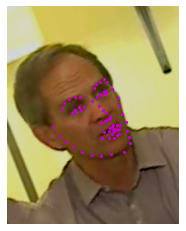

38


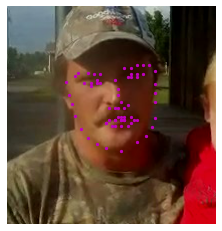

39


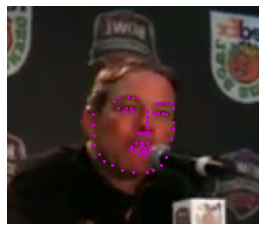

40


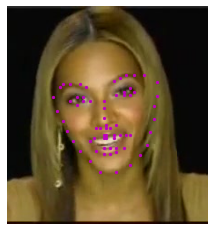

41


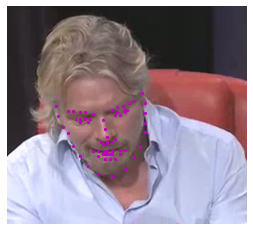

42


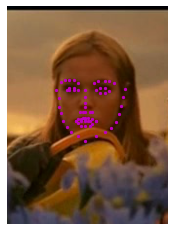

43


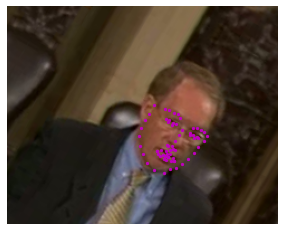

44


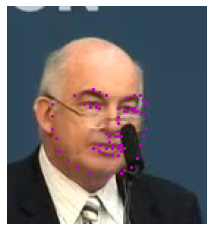

45


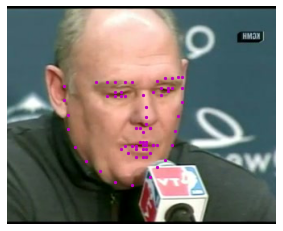

46


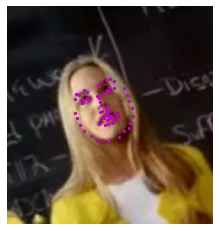

47


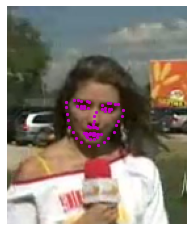

48


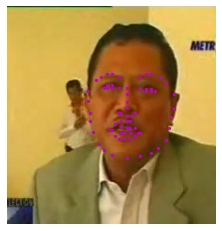

49


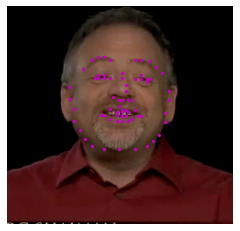

50


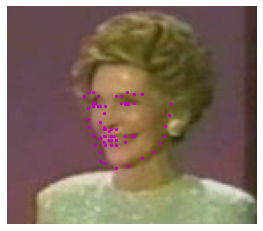

51


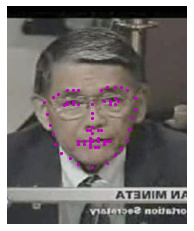

52


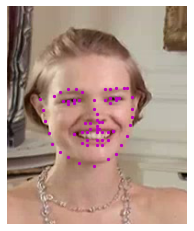

53


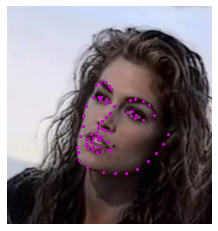

54


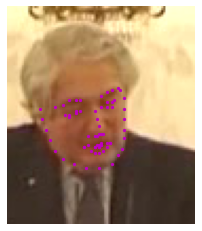

55


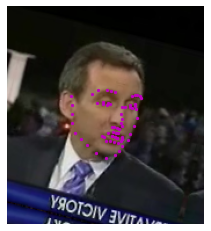

56


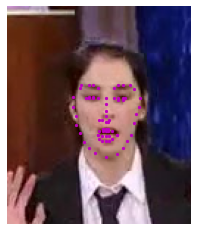

57


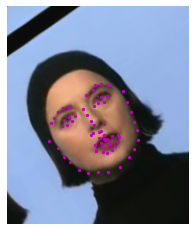

58


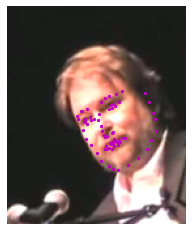

59


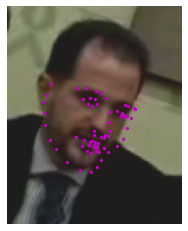

60


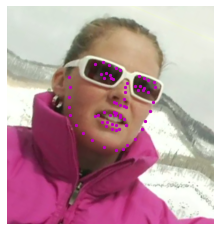

61


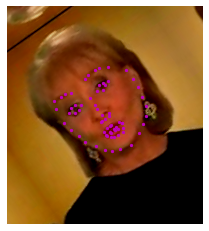

62


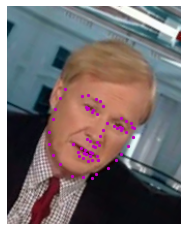

63


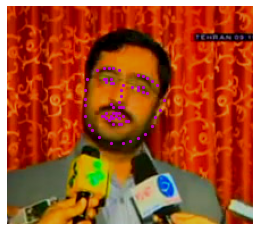

64


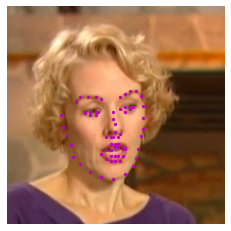

65


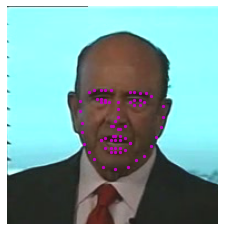

66


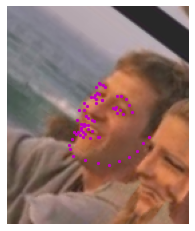

67


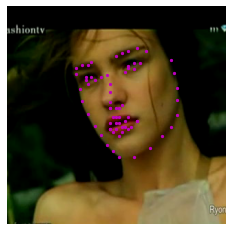

68


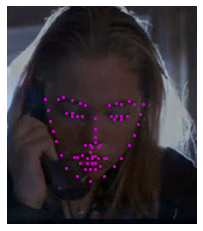

69


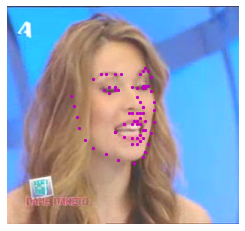

70


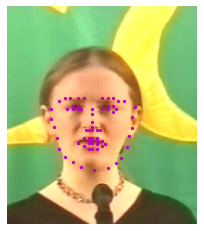

71


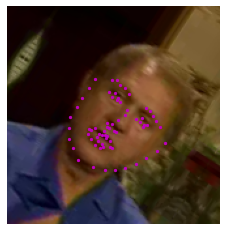

72


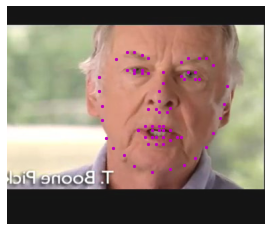

73


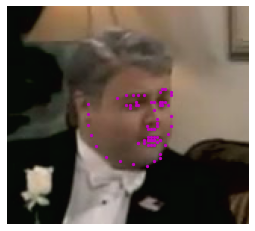

74


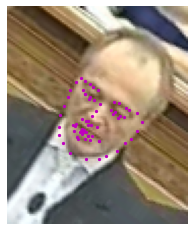

75


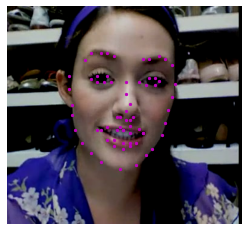

76


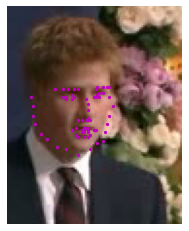

77


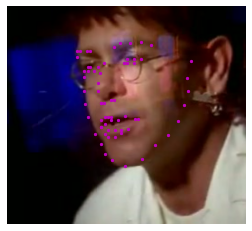

78


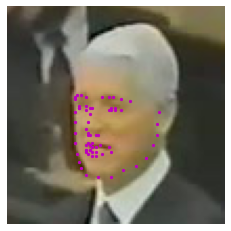

79


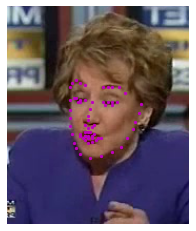

80


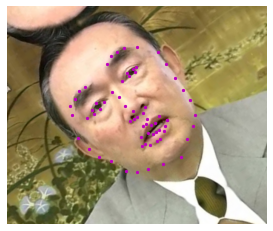

81


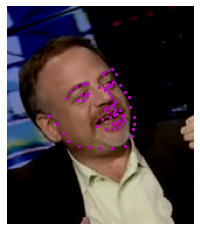

82


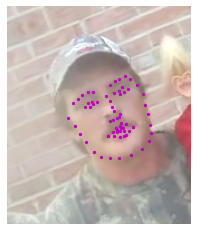

83


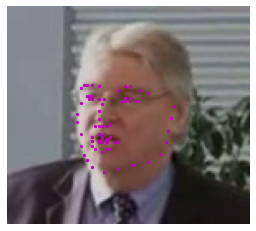

84


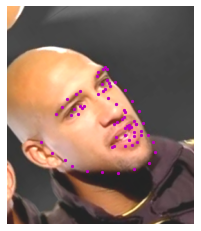

85


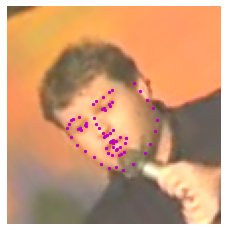

86


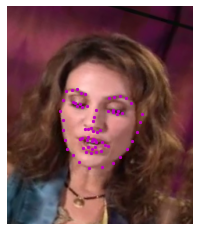

87


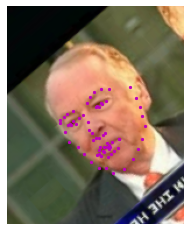

88


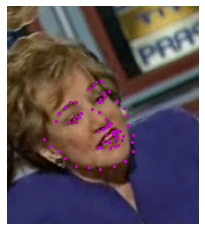

89


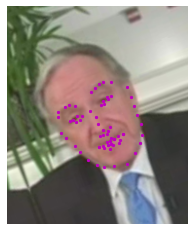

90


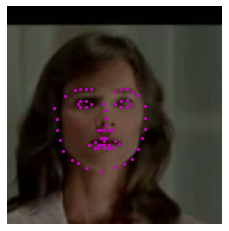

91


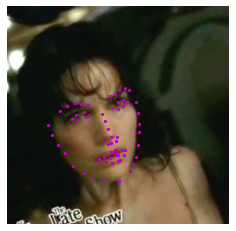

92


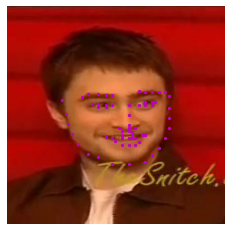

93


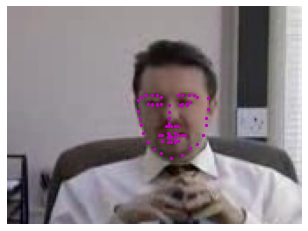

94


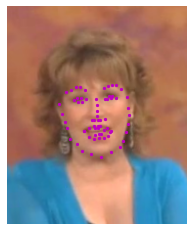

95


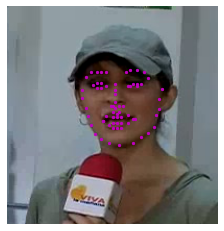

96


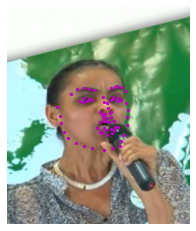

97


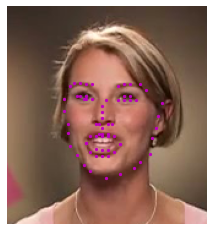

98


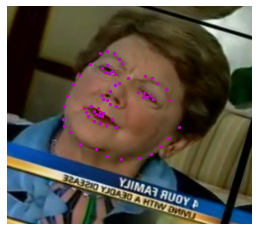

99


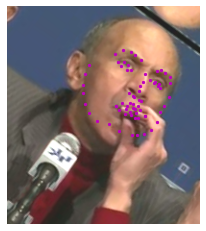

100


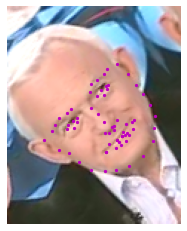

101


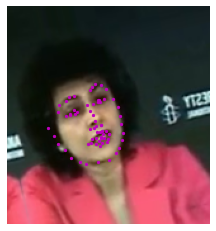

102


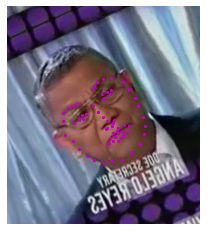

103


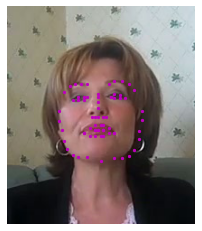

104


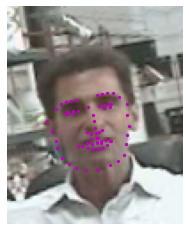

105


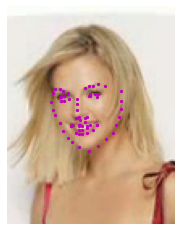

106


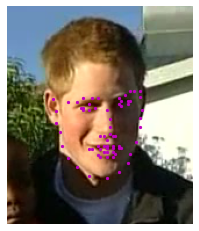

107


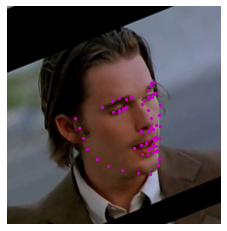

108


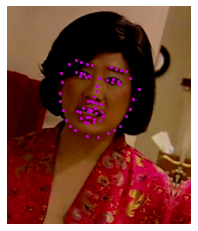

109


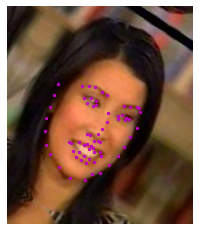

110


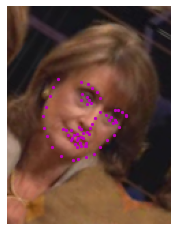

111


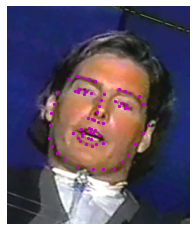

112


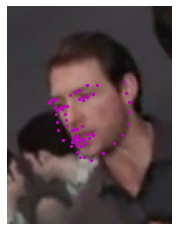

113


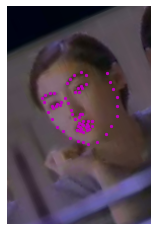

114


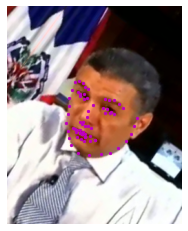

115


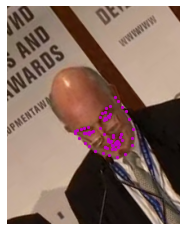

116


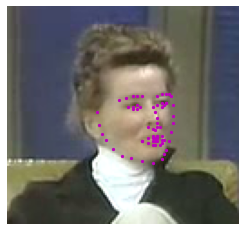

117


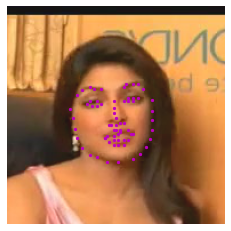

118


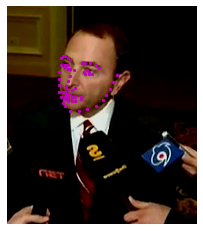

119


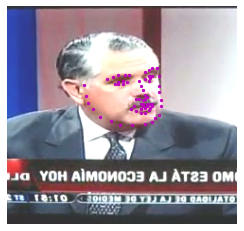

120


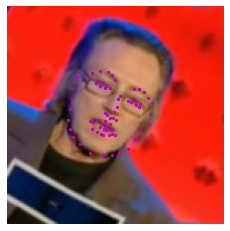

121


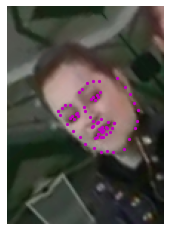

122


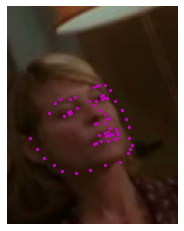

123


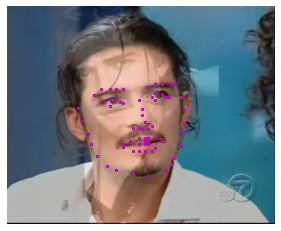

124


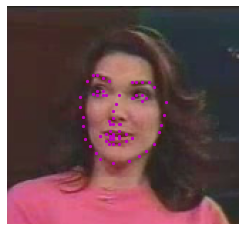

125


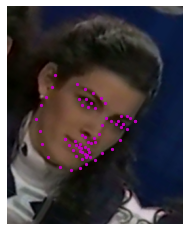

126


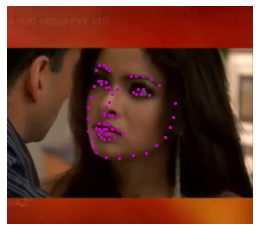

127


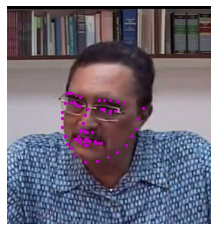

128


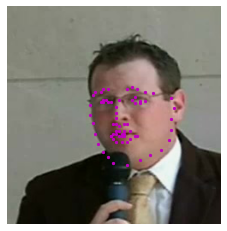

129


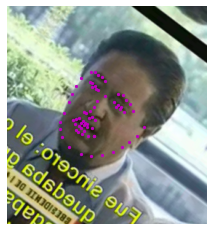

130


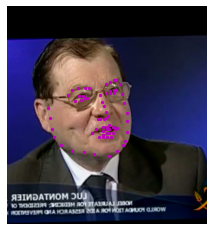

131


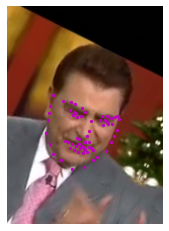

132


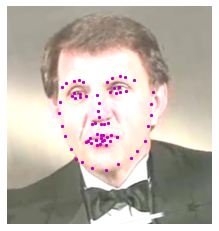

133


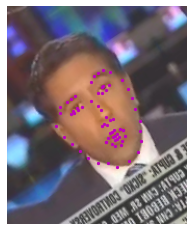

134


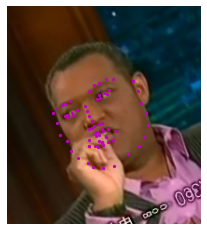

135


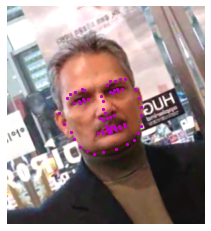

136


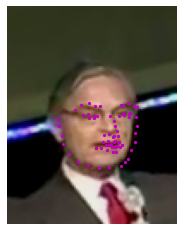

137


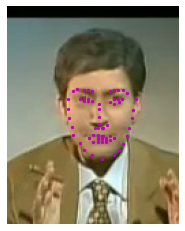

138


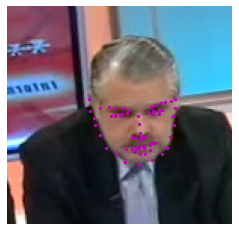

139


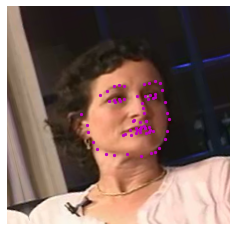

140


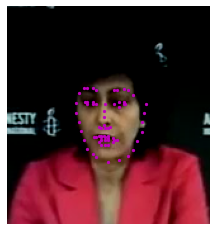

141


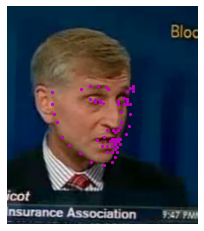

142


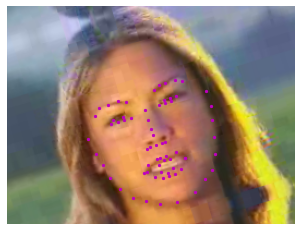

143


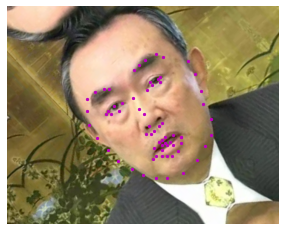

144


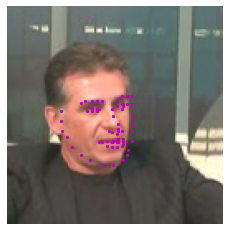

145


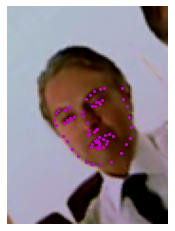

146


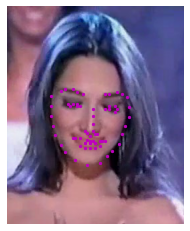

147


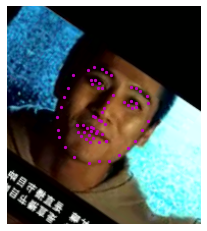

148


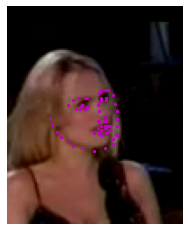

149


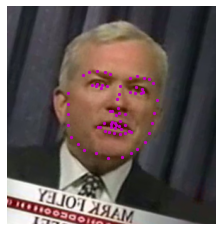

150


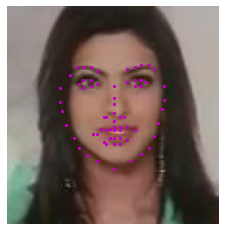

151


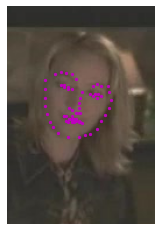

152


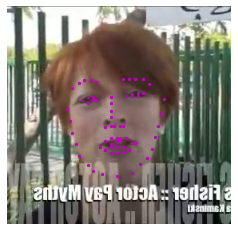

153


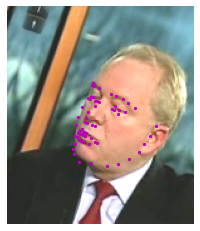

154


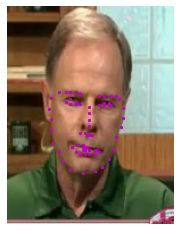

155


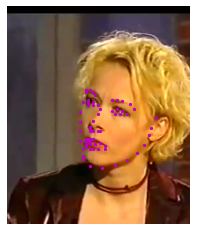

156


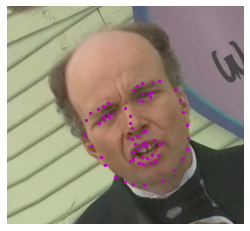

157


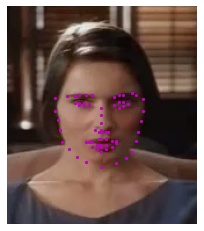

158


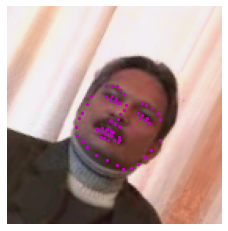

159


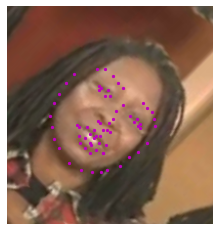

160


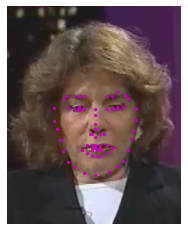

161


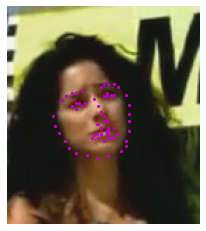

162


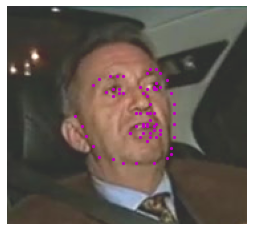

163


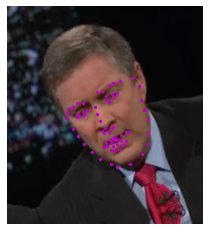

164


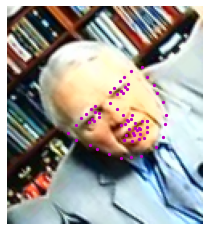

165


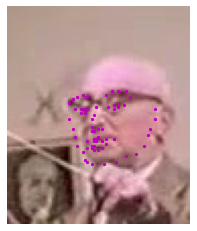

166


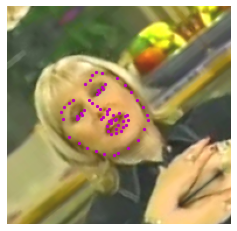

167


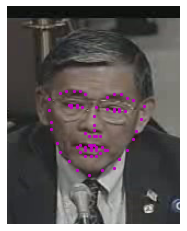

168


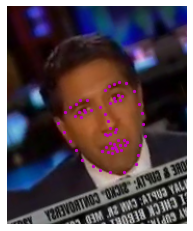

169


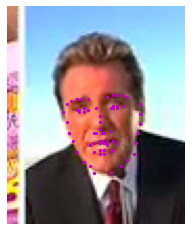

170


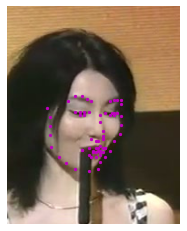

171


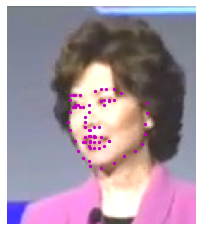

172


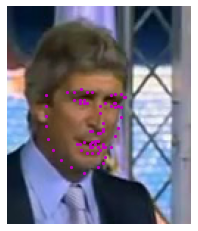

173


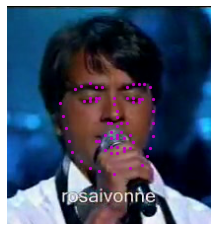

174


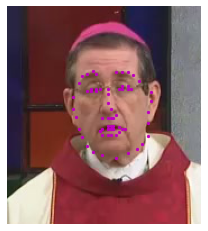

175


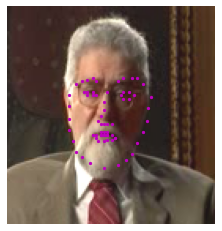

176


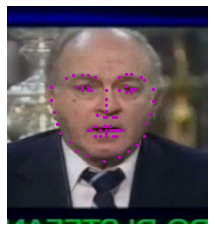

177


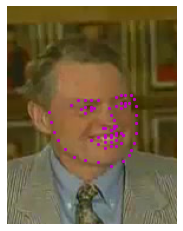

178


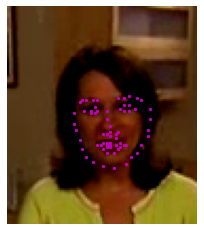

179


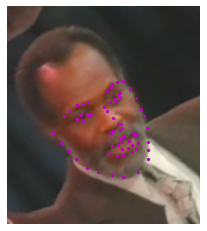

180


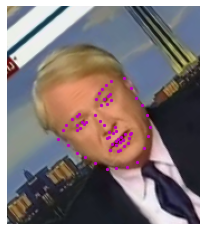

181


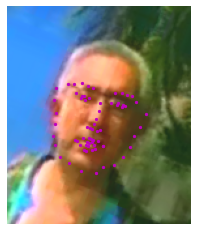

182


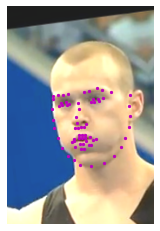

183


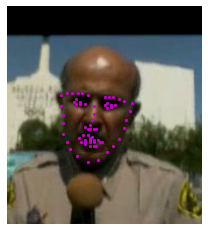

184


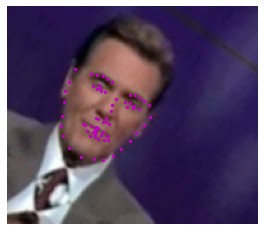

185


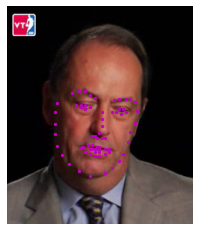

186


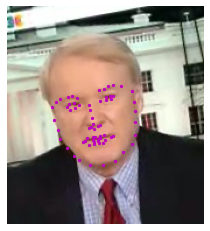

187


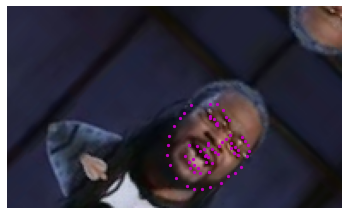

188


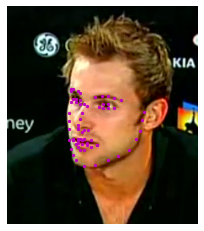

189


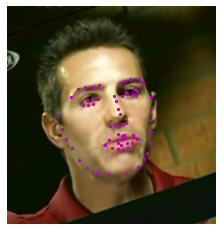

190


ValueError: ignored

In [299]:
for n in range(200):
  image_name = key_pts_frame.iloc[n, 0]
  key_pts = key_pts_frame.iloc[n, 1:]
  key_pts = np.array(key_pts, dtype=np.float32).reshape(-1, 2)
  image = cv2.imread(f'/data/training/{image_name}')
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  print(n)
  transformed = transform_training(image=image, keypoints=key_pts)
  transformed['keypoints'] = np.array(transformed['keypoints'], dtype=np.float32).reshape(-1, 2)
  visualize_keypoints(transformed['image'], transformed['keypoints'])

In [292]:
class FacialKeypointsDataset(Dataset):
  def __init__(self, csv_file, root_dir, transform=None):
    self.key_pts_frame = pd.read_csv(csv_file)
    self.root_dir = root_dir
    self.transform = transform

  def __len__(self):
    return len(self.key_pts_frame)

  def __getitem__(self, idx):
    image_name = os.path.join(self.root_dir, self.key_pts_frame.iloc[idx, 0])
    image = cv2.imread(image_name)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    if image.shape[2] == 4:
      image = image[:, :, 0:3]

    key_point = self.key_pts_frame.iloc[idx, 1:]
    key_point = np.array(key_point, dtype=np.float32).reshape(-1, 2)

    if self.transform:
      transformed = self.transform(image=image, keypoints=key_point)
      transformed['keypoints'] = np.array(transformed['keypoints'], dtype=np.float32).reshape(-1, 2)
      image = transformed['image']
      key_point = transformed['keypoints']

    image = torch.from_numpy(image)
    key_point = np.array(key_point, dtype=np.float32)
    key_point = torch.from_numpy(key_point)
      
    return image, key_point

In [293]:
!ls /data/

test			   training			  train-test-data.zip
test_frames_keypoints.csv  training_frames_keypoints.csv  train-test-data.zip.1


In [294]:
training_dataset = FacialKeypointsDataset(csv_file='/data/training_frames_keypoints.csv', root_dir='/data/training/', transform=transform_training)
test_dataset = FacialKeypointsDataset(csv_file='/data/test_frames_keypoints.csv', root_dir='/data/test/', transform=transform_test)

In [295]:
print(f'Number of training dataset: {len(training_dataset)}')

Number of training dataset: 3462


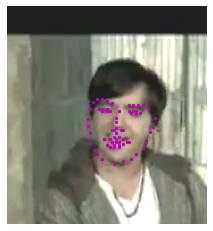

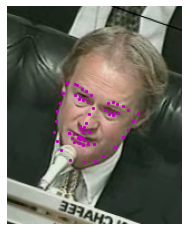

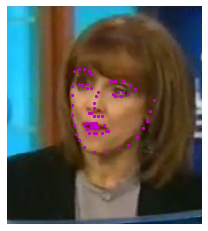

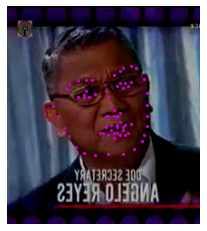

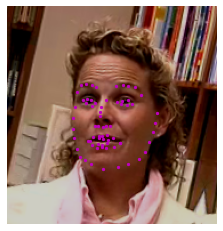

...

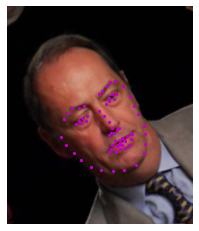

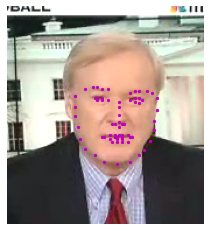

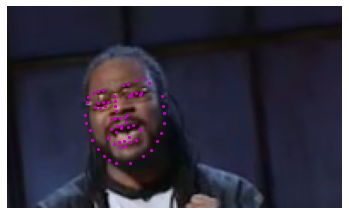

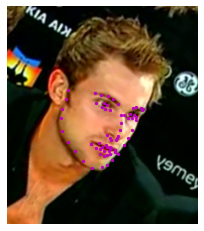

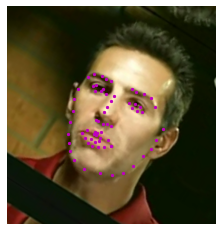

ValueError: ignored

In [297]:
num_share = 200

for idx, (image, key_pts) in enumerate(training_dataset):
  if idx < num_share:
    visualize_keypoints(image, key_pts)
  else:
    break
  # image = np.array(training_dataset.__getitem__(i)['image'])
  # key_pts = np.array(training_dataset.__getitem__(i)['keypoints'])

  # visualize_keypoints(image, key_pts)